# NuMu CC Pi0 Selection and Reconstruction for ML Reco Analysis
#### This notebook describes the selection and reconstruction of NuMu CC neutral pions in the context of the ICARUS ML Reco chain. 

## Introduction

At ICARUS, a comprehensive study of numu CC pi0 events is currently being carried out.  

<div>
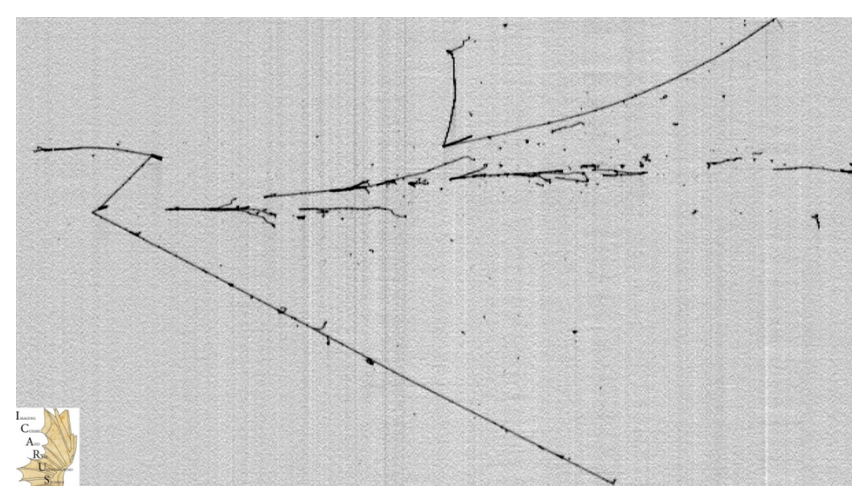
</div>

This study seeks to inform analyses that focus on reconstruction of the invariant diphoton mass peak, as well as future cross section analyses.


In [1]:
# Basic boilerplate imports
import numpy as np
import pandas as pd
import yaml, os, sys, re

# Visualization Tools
import plotly
import plotly.graph_objs as go
import plotly.express as px
from itertools import cycle
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import matplotlib.pyplot as plt
import seaborn as sns

# Analysis
LARTPC_MLRECO_PATH = "/sdf/group/neutrino/koh0207/lartpc_mlreco3d/"
sys.path.append(LARTPC_MLRECO_PATH)
from analysis.post_processing.evaluation.match import generate_match_pairs
from mlreco.visualization.plotly_layouts import plotly_layout3d
from mlreco.visualization.points import get_event_displays
from mlreco.utils.utils import pixel_to_cm
from collections import defaultdict

Welcome to JupyROOT 6.22/08


## Configuration
Load analysis config file and initialize analysis tools manager

In [2]:
# Load config file
config = None # We are using pre-processed h5 files and therefore do not need to forward the full chain

# Load anatools config file
DATA_PATH = '/sdf/data/neutrino/icarus/workshop2023/reco/bnb_numu_corsika_mini_reco.h5'
# DATA_PATH = '/sdf/data/neutrino/icarus/bnb_numu_cosmic/mlreco_07072023/mlreco_output_bnb_numu_corsika_processed_*.h5'
anaconfig = '../anaconfig.cfg' # Inside the main directory
anaconfig = yaml.safe_load(open(anaconfig, 'r').read().replace('DATA_PATH', DATA_PATH))

In [3]:
# Initialize Anatools manager
from analysis.manager import AnaToolsManager
manager = AnaToolsManager(anaconfig, cfg=config)
manager.initialize()

Registered /sdf/data/neutrino/icarus/workshop2023/reco/bnb_numu_corsika_mini_reco.h5


## Selection
To understand the criteria of selecting a numu CC pi0 event, we can look at a single event window to understand the event topology.

In [4]:
# Load a single image
ENTRY_NUM = 37
data, result = manager.forward(ENTRY_NUM)

In [5]:
# Retrieve data structures
manager.load_representations(data, result, mode='all')
manager.run_post_processing(data, result)
truth_interactions = result['truth_interactions'][0]
interactions = result['interactions'][0]
meta = data['meta'][0]

In [6]:
# Get relevant traces for visualization
traces_true = get_event_displays(truth_interactions, 
                                 color='id', 
                                 size=1, 
                                 mode='points', 
                                 colorscale='rainbow',
                                 scatter_vertices=True)
traces_reco = get_event_displays(interactions, 
                                 color='id', 
                                 size=1, 
                                 mode='points', 
                                 colorscale='rainbow',
                                 scatter_vertices=True)

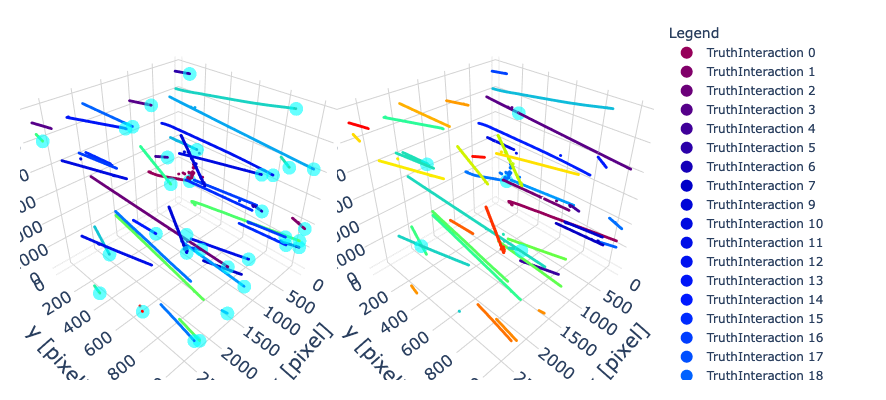

In [7]:
# Template cell for side-by-side event displays
make_plots = True
if make_plots:
    fig = make_subplots(rows=1, cols=2,
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        horizontal_spacing=0.05, vertical_spacing=0.04)

    fig.add_traces(traces_true, rows=len(traces_true) * [1], cols=len(traces_true) * [1])
    fig.add_traces(traces_reco, rows=len(traces_reco) * [1], cols=len(traces_reco) * [2])

    fig.layout = plotly_layout3d()
    fig.update_layout(showlegend=True,
                      legend=dict(xanchor="left"),
                     autosize=True,
                     height=400,
                     width=800,
                     margin=dict(r=20, l=20, b=20, t=20))
    iplot(fig)

##### Among many cosmic rays, the event shown above contains one numu CC pi0 interaction.
##### At the truth level (left display), the pi0 and its daughter showers are identified as follows:
1. Identify interactions containing one primary muon and at least two primary photons 
2. Group pairs of photons that originate from common parent track ID 
3. Enforce parent PDG code is that of a neutral pion 

In [8]:
# Find true pi0 from above display
true_pi0_showers = []
for true_int in truth_interactions:
    true_primary_pi0_dict = defaultdict(list)
    if len([p for p in true_int.particles if (p.pid == 2) and (p.is_primary)]) != 1:
        continue
    for p in true_int.particles:
        if (p.pid == 0) and (p.is_primary) and (p.asis.parent_pdg_code() == 111):
            true_primary_pi0_dict[p.asis.parent_track_id()].append(p)
    true_primary_pi0_dict = {k:v for k,v in true_primary_pi0_dict.items() if len(v) == 2}
    true_pi0_showers.append(true_primary_pi0_dict)

true_shower_list = [list(true_pi0_showers[0].items())[0][1][0], list(true_pi0_showers[0].items())[0][1][1]]
true_sh0 = sorted(true_shower_list, key=lambda sh: sh.asis.energy_init(), reverse=True)[0]
true_sh1 = sorted(true_shower_list, key=lambda sh: sh.asis.energy_init(), reverse=True)[1]
print(true_sh0, true_sh1)

TruthParticle( Image ID=37  | Particle ID=6   | Semantic_type: Shower      | PID: Photon   | Primary: 1  | Interaction ID: 0  | Size: 1227  | Volume: 0  | Match: [3]) TruthParticle( Image ID=37  | Particle ID=5   | Semantic_type: Shower      | PID: Photon   | Primary: 1  | Interaction ID: 0  | Size: 526   | Volume: 0  | Match: [5])


##### To select this event in reco (right display), a similar procedure is followed:
1. Identify interactions containing one reconstructed primary muon and at least two reconstructed primary photons
2. Select two photons with greatest charge to be those of candidate pi0 

In [9]:
# Find reco pi0 from above display
reco_pi0s = []
for reco_int in interactions:
    if len([p for p in reco_int.particles if (p.pid == 2) and (p.is_primary)]) != 1:
        continue
    if len([p for p in reco_int.particles if (p.pid == 0) and (p.is_primary)]) < 2:
        continue
    reco_shower_list = sorted([p for p in reco_int.particles if (p.pid == 0) and (p.is_primary == True)], key=lambda p : p.depositions_sum, reverse=True)
    reco_showers = (reco_shower_list[0], reco_shower_list[1])
    reco_pi0s.append(reco_showers)

reco_pi0_showers = reco_pi0s[0]
reco_sh0 = reco_pi0_showers[0]
reco_sh1 = reco_pi0_showers[1]
print(reco_sh0)
print(reco_sh1)

Particle( Image ID=37  | Particle ID=3   | Semantic_type: Shower      | PID: Photon   | Primary: 1  | Interaction ID: 48 | Size: 1249  | Volume: 0  | Match: [6])
Particle( Image ID=37  | Particle ID=5   | Semantic_type: Shower      | PID: Photon   | Primary: 1  | Interaction ID: 48 | Size: 551   | Volume: 0  | Match: [5])


### Invariant Mass Calculation
##### Once the pi0's decay photons have been identified, only a few quantities are needed to calculate the invariant mass.
##### At the truth level, these quantities are:
1. the true energies each photon
2. the true momentum vectors of each photon (for opening angle calculation)

In [10]:
# Calculate true pi0 mass
true_photon0_E = true_sh0.energy_init
true_photon1_E = true_sh1.energy_init
true_photon0_direction = (true_sh0.asis.px(), true_sh0.asis.py(), true_sh0.asis.pz()) / np.linalg.norm((true_sh0.asis.px(), true_sh0.asis.py(), true_sh0.asis.pz()))
true_photon1_direction = (true_sh1.asis.px(), true_sh1.asis.py(), true_sh1.asis.pz()) / np.linalg.norm((true_sh1.asis.px(), true_sh1.asis.py(), true_sh1.asis.pz()))
true_cos_opening_angle = np.dot(true_photon0_direction, true_photon1_direction)

true_pi0_mass = np.sqrt(2*true_photon0_E*true_photon1_E*(1 - true_cos_opening_angle))
print('True γγ Invariant Mass: ' + str(true_pi0_mass) + ' MeV')

True γγ Invariant Mass: 134.9766 MeV


At the reco level, quantities needed to calculate the invariant mass are:
1. the reco energies each shower
2. the reco start point of each shower
3. the reco interaction vertex  
For each shower, a vector is formed from the interaction vertex to the shower start point.  The opening angle is then calculated as the angle between the two vertex-start point vectors. 

Shower energy is calculated using the shower energy approximation from ```ShowerEnergyReco.ipynb```.

In [11]:
# Function to calculate shower energy
def calculate_shower_energy(shower, meta):
    # constants
    work_func = 23.6 * 10**(-6)
    gain = 86.83 #e/adc
    R = 0.66
    tau = 3000 #us
    drift_v = 1.57565 #mm/us

    anode_ee_x = -358.49
    cathode_ee_x = -210.29
    cathode_ew_x = -210.14
    anode_ew_x = -61.94
    anode_we_x = 61.94
    cathode_we_x = 210.14
    cathode_ww_x = 210.29
    anode_ww_x = 358.49

    total_energy = 0
    for pt, dep in zip(shower.points, shower.depositions):
        det_pt = pixel_to_cm(pt, meta)
        det_pt = pt
        # EE
        if det_pt[0] < cathode_ee_x:
            drift_t = 10*abs(det_pt[0] - anode_ee_x) / drift_v
        # EW
        elif (det_pt[0] > cathode_ew_x) and (det_pt[0] < anode_ew_x):
            drift_t = 10*abs(det_pt[0] - anode_ew_x) / drift_v
        # WE
        elif (det_pt[0] > anode_we_x) and (det_pt[0] < cathode_we_x):
            drift_t = 10*abs(det_pt[0] - anode_we_x) / drift_v
        # WW
        elif det_pt[0] > cathode_ww_x:
            drift_t = 10*abs(det_pt[0] - anode_ww_x) / drift_v
        else:
            continue
        
        dep_E = work_func * gain * np.exp(drift_t / tau) * (1/R) * dep
        total_energy = total_energy + dep_E
    return total_energy

In [12]:
# Calculate reco pi0 mass
reco_sh0_E = calculate_shower_energy(reco_sh0, meta)
reco_sh1_E = calculate_shower_energy(reco_sh1, meta)
reco_sh0_startpoint = reco_sh0.start_point
reco_sh1_startpoint = reco_sh1.start_point
reco_int_vertex = [i.vertex for i in interactions if i.id == 48][0]
reco_sh0_dir = (reco_sh0_startpoint - reco_int_vertex) / np.linalg.norm((reco_sh0_startpoint - reco_int_vertex))
reco_sh1_dir = (reco_sh1_startpoint - reco_int_vertex) / np.linalg.norm((reco_sh1_startpoint - reco_int_vertex))
reco_cos_opening_angle = np.dot(reco_sh0_dir, reco_sh1_dir)
reco_pi0_mass = np.sqrt(2*reco_sh0_E*reco_sh1_E*(1 - reco_cos_opening_angle))
print('Reconstructed γγ Invariant Mass: ' + str(reco_pi0_mass) + ' MeV')

Reconstructed γγ Invariant Mass: 70.62251243342234 MeV


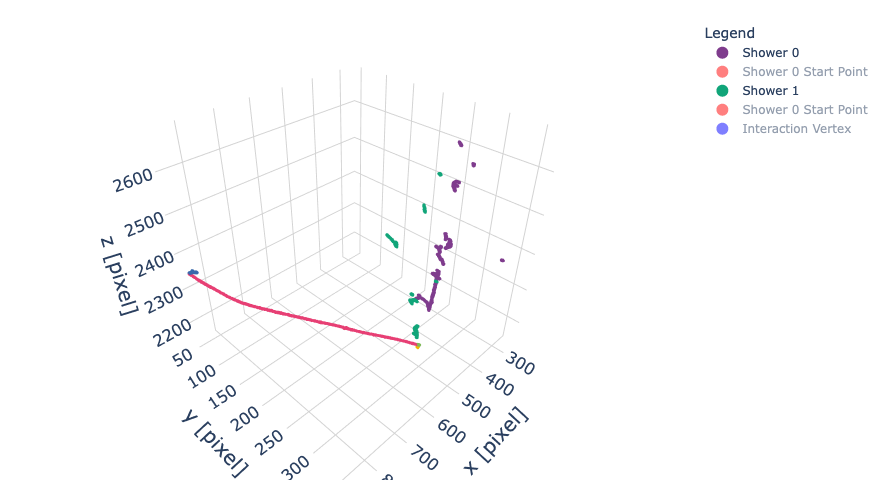

In [13]:
# Plot reco pi0
traces = []
palette = np.array(px.colors.qualitative.Bold)
palette_iter = cycle(palette[2:])
pi0_int = [i for i in interactions if i.id == 48][0]
for p in pi0_int.particles:
    if p.id == reco_sh0.id:
        shower0_trace = go.Scatter3d(x = p.points[:,0],
                                     y = p.points[:,1],
                                     z = p.points[:,2],
                                     mode = 'markers',
                                     marker = dict(size = 1, color = palette[0]),
                                     text = 'Particle ID: ' + str(p.id),
                                     name = 'Shower 0')
        traces.append(shower0_trace)
        
        shower0_stp_trace = go.Scatter3d(x=[p.start_point[0]],
                                         y=[p.start_point[1]],
                                         z=[p.start_point[2]],
                                         mode='markers',
                                         marker=dict(size=3, color='red'),
                                         text='Shower 0 Start Point',
                                         name='Shower 0 Start Point',
                                         visible='legendonly')
        traces.append(shower0_stp_trace)
        
    elif p.id == reco_sh1.id:
        shower1_trace = go.Scatter3d(x = p.points[:,0],
                                     y = p.points[:,1],
                                     z = p.points[:,2],
                                     mode = 'markers',
                                     marker = dict(size = 1, color = palette[1]),
                                     text = 'Particle ID: ' + str(p.id),
                                     name = 'Shower 1')
        traces.append(shower1_trace)
        
        shower1_stp_trace = go.Scatter3d(x=[p.start_point[0]],
                                         y=[p.start_point[1]],
                                         z=[p.start_point[2]],
                                         mode='markers',
                                         marker=dict(size=3, color='red'),
                                         text='Shower 0 Start Point',
                                         name='Shower 0 Start Point',
                                         visible='legendonly')
        traces.append(shower1_stp_trace)
        
    else:
        other_trace = go.Scatter3d(x = p.points[:,0],
                                   y = p.points[:,1],
                                   z = p.points[:,2],
                                   mode = 'markers',
                                   marker = dict(size=1, color = next(palette_iter)),
                                   text = 'Particle ID: ' + str(p.id),
                                   name = 'Other Particles',
                                   showlegend = False)
        traces.append(other_trace)
    
vertex_trace = go.Scatter3d(x=[reco_int_vertex[0]],
                            y=[reco_int_vertex[1]],
                            z=[reco_int_vertex[2]],
                            mode='markers',
                            marker=dict(size=3, color='blue'),
                            text='Interaction Vertex',
                            name='Interaction Vertex',
                            visible='legendonly')
traces.append(vertex_trace)


fig = go.Figure(traces)
fig.layout = plotly_layout3d()
fig.update_layout(showlegend=True,
                  legend=dict(xanchor="left"),
                  autosize=True,
                  height=500,
                  width=1000,
                  margin=dict(r=20, l=20, b=20, t=20))
iplot(fig)

## High-Level Analysis
The rest of this notebook assumes the `run.py` driver script has been ran
```bash
> python3 $LARTPC_MLRECO_PATH/analysis/run.py $PI0_RECO_CONFIG_PATH
```
and that your `LARTPC_MLRECO_PATH/analysis/producers/scripts/` directory contains **pi0_selector.py**

The configuration file used for pi0 studies is similar to the analysis configuration file included in the workshop repo (anaconfig.cfg)

Two output files are produced as a result of the above command:
1. **reco_pi0s.csv** (reco pi0 interactions and their matched true counterparts)
2. **true_pi0s.csv** (true pi0 interactions and their matched reco counterparts)

All scripts referenced here can be found at `/sdf/group/neutrino/lkashur/csu_workshop_2023/`.

> **Note**
> While the steps mentioned here are now typical, the results shown below are from a previous workflow that included different versions of both lartpc_mlreco3d and the pi0 selection macro (for the purpose of higher statistics).  The updated workflow will be used for pi0 analysis in the coming weeks.  

In [14]:
# Load pre-made CSVs

# Nu + Cosmic
reco_pi0_nucosmic_dfs = []
true_pi0_nucosmic_dfs = []
rootdir_nucosmic = '/fs/ddn/sdf/group/neutrino/lkashur/icarusml/log_25_03_2023_nucosmic/'
for subdir, dirs, files in os.walk(rootdir_nucosmic):
    for file in files:
        if file == 'pi0s_pred.csv':
            try:
                df = pd.read_csv(os.path.join(subdir, file), sep=',')
                reco_pi0_nucosmic_dfs.append(df)
            except:
                continue
        if file == 'pi0s_true.csv':
            try:
                df = pd.read_csv(os.path.join(subdir, file), sep=',')
                true_pi0_nucosmic_dfs.append(df)
            except:
                continue
                
reco_pi0s_nucosmic = pd.concat(reco_pi0_nucosmic_dfs)  
true_pi0s_nucosmic = pd.concat(true_pi0_nucosmic_dfs)

# In-time cosmics
reco_pi0_intime_dfs = []
true_pi0_intime_dfs = []
rootdir_intime = '/fs/ddn/sdf/group/neutrino/lkashur/icarusml/log_21_04_2023_intimecosmic/'
for subdir, dirs, files in os.walk(rootdir_intime):
    for file in files:
        if file == 'pi0s_pred.csv':
            try:
                df = pd.read_csv(os.path.join(subdir, file), sep=',')
                reco_pi0_intime_dfs.append(df)
            except:
                continue
        if file == 'pi0s_true.csv':
            try:
                df = pd.read_csv(os.path.join(subdir, file), sep=',')
                true_pi0_intime_dfs.append(df)
            except:
                continue
                
reco_pi0s_intime = pd.concat(reco_pi0_intime_dfs)  
true_pi0s_intime = pd.concat(true_pi0_intime_dfs)

### Weight in-time cosmics
See Justin's methodology here: [SBN-doc-30571](https://sbn-docdb.fnal.gov/cgi-bin/sso/ShowDocument?docid=30571)

In [15]:
# Weight in-time sample
scale = (((14215/14215.0)*1.253e19) / 2.05e14) / (9070) # See Justin's slides
reco_pi0s_nucosmic['weight'] = reco_pi0s_nucosmic.apply(lambda x : 1, axis=1)
reco_pi0s_intime['weight'] = reco_pi0s_intime.apply(lambda x : scale, axis=1)
reco_pi0s = pd.concat([reco_pi0s_nucosmic, reco_pi0s_intime], ignore_index=True)
reco_pi0s['uid'] = reco_pi0s.index

true_pi0s = true_pi0s_nucosmic
true_pi0s['weight'] = true_pi0s.apply(lambda x : 1, axis=1)

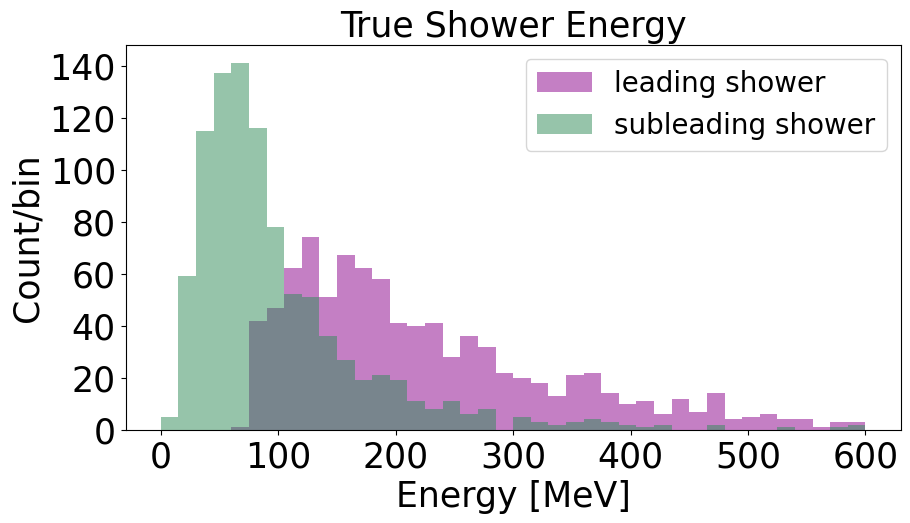

In [16]:
# Plot true shower energies
plt.figure(figsize=(10,5))
plt.hist(true_pi0s.shower0_energy, histtype='stepfilled', label='leading shower', range=[0,600], bins=40, linewidth=3, alpha=0.50, color='darkmagenta')
plt.hist(true_pi0s.shower1_energy, histtype='stepfilled', label='subleading shower', range=[0,600], bins=40, linewidth=3, alpha=0.50, color='seagreen')
plt.legend(fontsize=20)
plt.xlabel('Energy [MeV]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('True Shower Energy', fontsize=25)
plt.show()

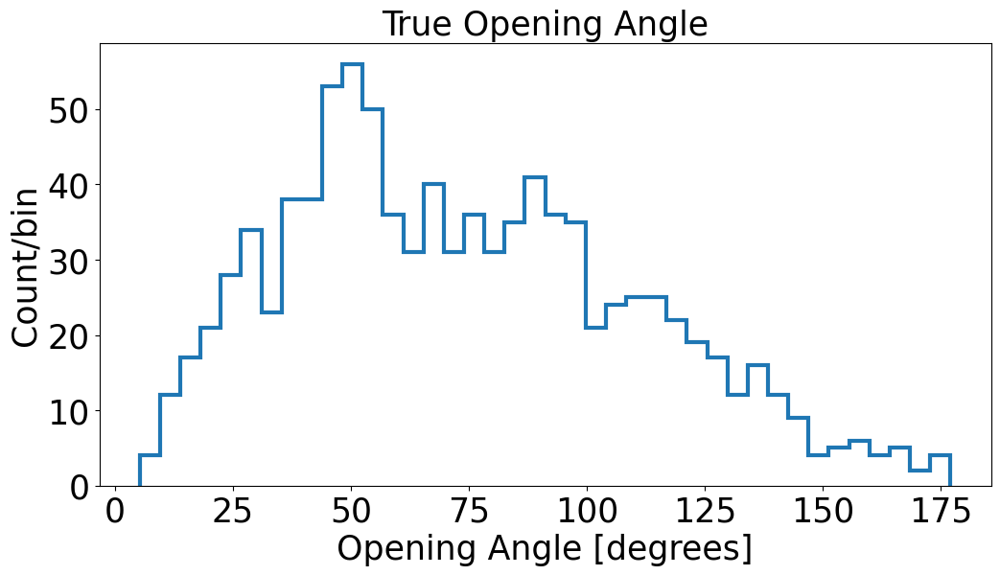

In [17]:
# Plot true opening angle
plt.figure(figsize=(12,6))
plt.hist(np.degrees(np.arccos(true_pi0s.cos_angle)), histtype='step', bins=40, linewidth=3)
plt.xlabel('Opening Angle [degrees]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('True Opening Angle', fontsize=25)
plt.show()

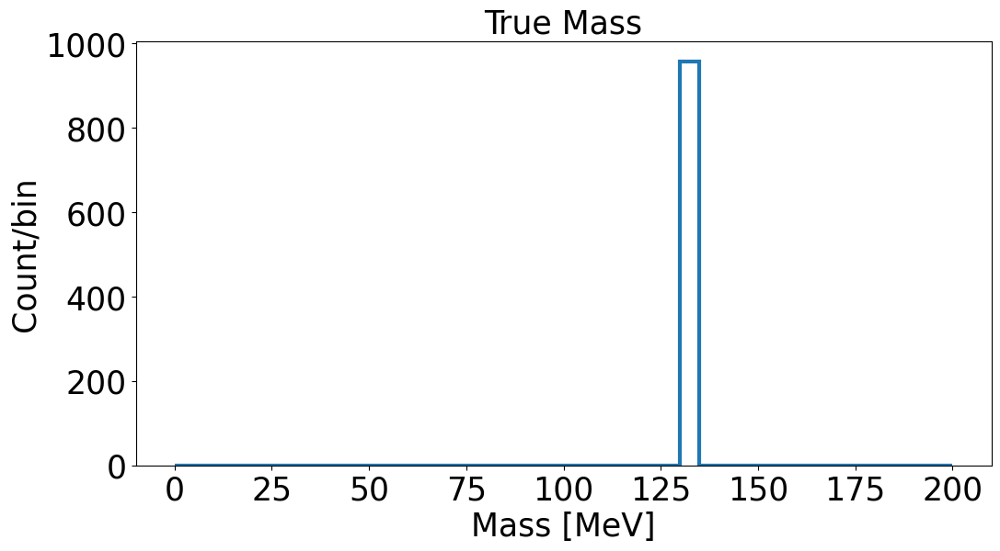

In [18]:
# Sanity Check - True pi0 Mass Distribution
plt.figure(figsize=(12,6))
plt.hist(true_pi0s.mass, histtype='step', bins=40, linewidth=3, range=[0,200])
plt.xlabel('Mass [MeV]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('True Mass', fontsize=25)
plt.show()

In [19]:
# Number of true pi0s
print('Number of true pi0s: ' + str(len(true_pi0s)))

# Total number of events
print('Total number of events: ' + str(14215))

Number of true pi0s: 958
Total number of events: 14215


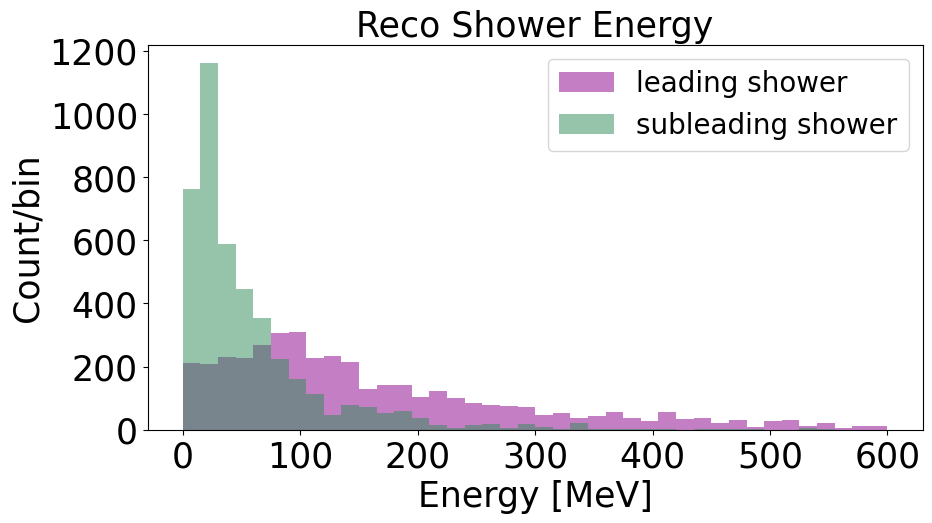

In [20]:
# Plot reco shower energies
plt.figure(figsize=(10,5))
plt.hist(reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].shower0_energy, weights=reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].weight, histtype='stepfilled', label='leading shower', range=[0,600], bins=40, linewidth=3, alpha=0.50, color='darkmagenta')
plt.hist(reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].shower1_energy, weights=reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].weight, histtype='stepfilled', label='subleading shower', range=[0,600], bins=40, linewidth=3, alpha=0.50, color='seagreen')
plt.legend(fontsize=20)
plt.xlabel('Energy [MeV]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('Reco Shower Energy', fontsize=25)
plt.show()

/usr/local/lib/python3.8/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning:

invalid value encountered in arccos



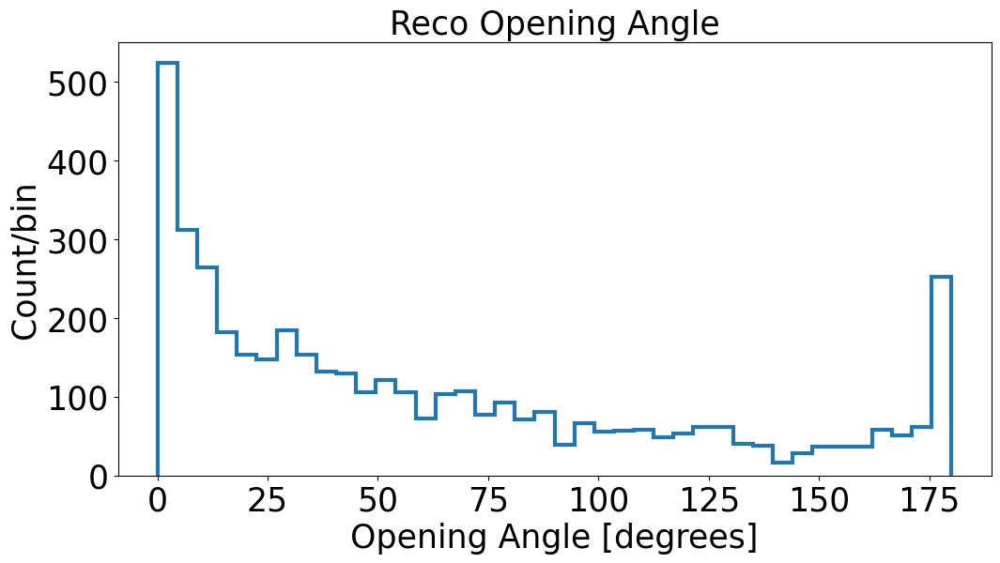

In [21]:
# Plot reco opening angle
plt.figure(figsize=(12,6))
plt.hist(np.degrees(np.arccos(reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].cos_angle)), weights=reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].weight, histtype='step', bins=40, linewidth=3)
plt.xlabel('Opening Angle [degrees]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('Reco Opening Angle', fontsize=25)
plt.show()

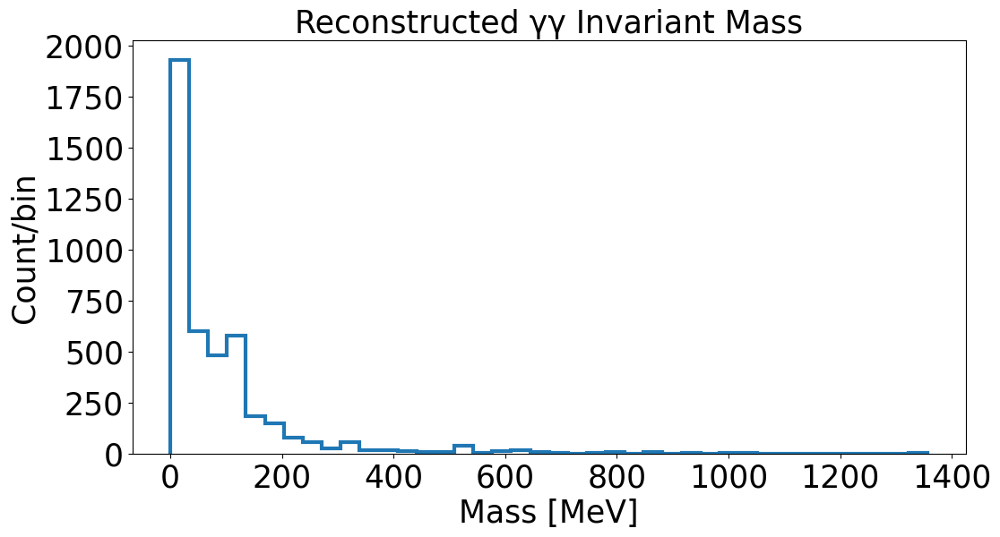

In [22]:
# Reco pi0 Mass Distribution
plt.figure(figsize=(12,6))
plt.hist(reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].mass, weights=reco_pi0s[reco_pi0s['interaction_vertex_is_valid'] == True].weight, histtype='step', bins=40, linewidth=3)
plt.xlabel('Mass [MeV]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Count/bin', fontsize=25)
plt.yticks(fontsize=25)
plt.title('Reconstructed γγ Invariant Mass', fontsize=25)
plt.show()

In [23]:
# UNCOMMENT FOR FLASH MATCHING CUT
reco_pi0s = reco_pi0s[(reco_pi0s['fmatch_time'] > 0) & (reco_pi0s['fmatch_time'] < 1.6)]

In [24]:
# Backtrack to truth
reco_pi0s_1mu1pi0 = reco_pi0s[(reco_pi0s.interaction_vertex_is_valid == True) &
                              (reco_pi0s.num_matched_primary_muons == 1) & 
                              (reco_pi0s.num_matched_primary_pi0s == 1) & 
                              (reco_pi0s.num_matched_cex_pi0s == 0)]

reco_pi0s_1muNpi0 = reco_pi0s[(reco_pi0s.interaction_vertex_is_valid == True) &
                              (reco_pi0s.num_matched_primary_muons == 1) & 
                              (reco_pi0s.num_matched_primary_pi0s > 1)  & 
                              (reco_pi0s.num_matched_cex_pi0s == 0)]

reco_pi0s_1muCex = reco_pi0s[(reco_pi0s.interaction_vertex_is_valid == True) &
                             (reco_pi0s.num_matched_primary_muons == 1) & 
                             (reco_pi0s.num_matched_cex_pi0s > 0)]

reco_pi0s_NC = reco_pi0s[(reco_pi0s.interaction_vertex_is_valid == True) & 
                         (reco_pi0s.num_matched_primary_muons < 1)]

reco_pi0s_other = reco_pi0s[(reco_pi0s.interaction_vertex_is_valid == True) &
                            (~reco_pi0s.uid.isin(reco_pi0s_1mu1pi0.uid)) & 
                            (~reco_pi0s.uid.isin(reco_pi0s_1muNpi0.uid)) & 
                            (~reco_pi0s.uid.isin(reco_pi0s_1muCex.uid)) & 
                            (~reco_pi0s.uid.isin(reco_pi0s_NC.uid))]

reco_pi0_categories_mass = [reco_pi0s_NC.mass.values.tolist(), 
                            reco_pi0s_1mu1pi0.mass.values.tolist(), 
                            reco_pi0s_1muNpi0.mass.values.tolist(), 
                            reco_pi0s_1muCex.mass.values.tolist(), 
                            reco_pi0s_other.mass.values.tolist()]

reco_pi0_categories_weight = [reco_pi0s_NC.weight.values.tolist(), 
                            reco_pi0s_1mu1pi0.weight.values.tolist(), 
                            reco_pi0s_1muNpi0.weight.values.tolist(), 
                            reco_pi0s_1muCex.weight.values.tolist(), 
                            reco_pi0s_other.weight.values.tolist()]

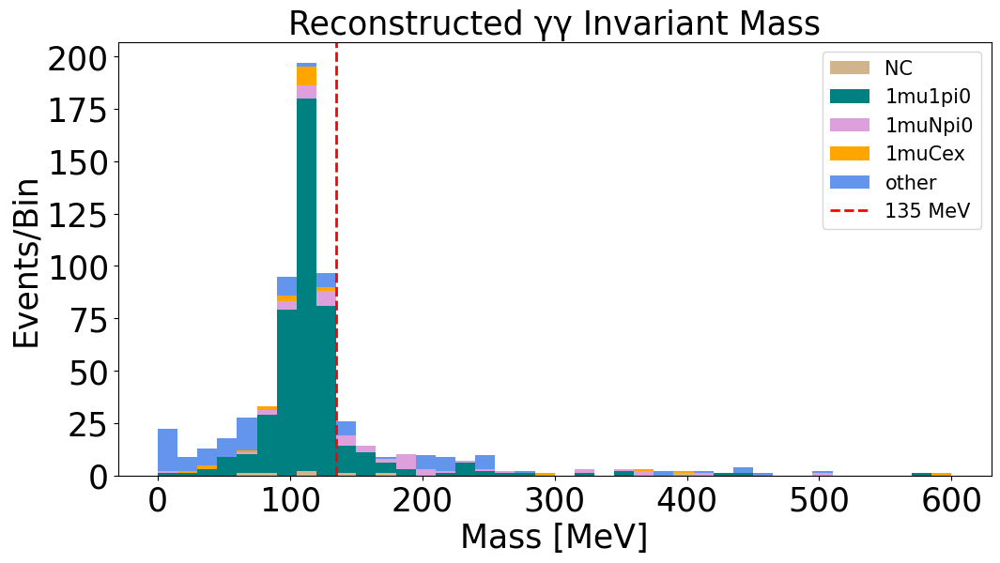

In [25]:
# Plot reco mass
colors = ['tan', 'teal', 'plum', 'orange', 'cornflowerblue']
plt.figure(figsize=(12,6))
plt.hist(reco_pi0_categories_mass,
         weights=reco_pi0_categories_weight,
         range=[0,600],
         stacked=True, 
         density=False, 
         bins=40,
         label=('NC', '1mu1pi0', '1muNpi0', '1muCex', 'other'), 
         color=colors)
plt.axvline(x=135, linestyle='dashed', color='red', label='135 MeV', linewidth=2)
plt.title('Reconstructed γγ Invariant Mass', fontsize=25)
plt.xlabel('Mass [MeV]', fontsize=25)
plt.xticks(fontsize=25)
plt.ylabel('Events/Bin', fontsize=25)
plt.yticks(fontsize=25)
#plt.ylim([0, 700])
plt.legend(fontsize=15)
plt.show()

In [26]:
# PURITY
purity_num = np.sum(reco_pi0s[(reco_pi0s.interaction_vertex_is_valid) & (reco_pi0s.num_matched_primary_muons == 1) & (reco_pi0s.num_matched_primary_pi0s == 1)]['weight'])
purity_denom = np.sum(reco_pi0s[(reco_pi0s.interaction_vertex_is_valid)]['weight'])
purity = purity_num / purity_denom

print('Purity: ' + str(purity))

Purity: 0.701347216551444


In [27]:
# EFFICIENCY
efficiency_num = np.sum(true_pi0s[(~true_pi0s.matched_primary_pi0_shower_leading_energy.isnull()) & (~true_pi0s.matched_primary_pi0_shower_leading_energy.isnull())]['weight'])
efficiency_denom = np.sum(true_pi0s['weight'])
efficiency = efficiency_num / efficiency_denom

print('Efficiency: ' + str(efficiency))

Efficiency: 0.8110647181628392


## Possible further exercises: 
- More detailed purity and efficiency study
    - Confusion matrices
    - Plot as function of relevant variables (neutrino energy, subleading shower energy, etc.)
- Assess shower energy resolution by fitting Gaussian to pi0 mass peak